In [1]:
# Import statements
from brian2 import *

In [2]:
# Parameter definition
# Simulation
duration = 4*second
defaultclock.dt = 1*ms

# Oscillators
seed(42)
N = []
N_init = [2, 5, 25, 50, 200]
repeats = 8
for n in N_init:
    N.extend([n]*repeats)
sync = 15
f0 = 8 # center freq [Hz]
sigma = 0.5 # normal std offset for omega

# Input stim
dt_stim = 1*ms
t_stim = 2*second
stim_dur = 100*ms
I0 = 20*amp
tv = linspace(0, duration/second, int(duration/(dt_stim))+1)
xstim = 1. * logical_and(tv>t_stim/second, tv<(t_stim+stim_dur)/second)
pulse_train = TimedArray(xstim*amp**-1, dt=dt_stim)

In [3]:
# Equations
# Kuramoto oscillators
kuramoto_eqs_stim = '''
    dTheta/dt = ((omega + (kN * PIF) - I_stim*X*sin(Theta - 0*pi/2)) * second**-1) : 1
    PIF = .5 * (sin(ThetaPreInput - Theta)) : 1
    ThetaPreInput : 1
    omega : 1 (constant)
    kN : 1 (shared)         # k/N ratio, affects sync.
    I_stim : amp (shared)   # this is the input gain, affects the phase reset aggressiveness
    X = pulse_train(t) : amp**-1 (shared)
'''

# synapses
syn_kuramoto_eqs = '''
    ThetaPreInput_post = Theta_pre
'''

# Order parameter group calculation equations
pop_avg_eqs = '''
    x : 1
    y : 1
    coherence = sqrt(x**2 + y**2) : 1
    phase = arctan(y/x) + int(x<0 and y>0)*pi - int(x<0 and y<0)*pi: 1
    rhythm = coherence * sin(phase) : 1
    test = y : 1
    rhythm_pos = coherence * (sin(phase)+1)/2 : 1
    rhythm_rect = rhythm_pos*nA : amp
'''

syn_avg_eqs = '''
    x_post = cos(Theta_pre)/N_incoming : 1 (summed)
    y_post = sin(Theta_pre)/N_incoming : 1 (summed)
'''

In [4]:
# Make the necessary groups
# Oscillators
N_tot = sum(N)
G_K = NeuronGroup(N_tot,
    model=kuramoto_eqs_stim,
    threshold='True',
    method='euler',
    name='Kuramoto_oscillators_N_%d' % N_tot)
#G_K.Theta = '2*pi*rand()' # uniform U~[0,2π]
#G_K.omega = '2*pi*(f0+sigma*randn())' # normal N~(f0,σ)
theta0 = 2*pi*rand(N_tot) # uniform U~[0,2π]
omega0 = 2*pi*(f0 + sigma*randn(N_tot)) # ~N(2πf0,σ)
G_K.Theta = theta0
G_K.omega = omega0
G_K.kN = sync
G_K.I_stim= I0

# Kuramoto order parameter group
G_pop_avg = NeuronGroup(len(N),
    model=pop_avg_eqs,
    #method='euler',
    name='Kuramoto_averaging')

print('General groups: done')

General groups: done


In [5]:
# Define subgroups
G_all = []
syn_all = []

kuramoto_mon_all = []
order_param_mon_all = []

idx0 = 0
idx1 = 0

for gnum in range(len(N)):
    N_curr = N[gnum]
    
    idx0 = idx1
    idx1 += N_curr
    
    # Subgroups
    G_K_curr = G_K[idx0:idx1]
    
    G_pop_avg_curr = G_pop_avg[gnum]
    r0 = 1/N_curr * sum(exp(1j*G_K_curr.Theta))
    G_pop_avg_curr.x = real(r0)  # avoid division by zero
    G_pop_avg_curr.y = imag(r0)
    
    G_all.append(G_K_curr)
    G_all.append(G_pop_avg_curr)
    
    
    # Synapses
    syn_kuramoto_curr =  Synapses(G_K_curr, G_K_curr, on_pre=syn_kuramoto_eqs, method='euler', name='Kuramoto_intra_{0}'.format(gnum))
    syn_kuramoto_curr.connect(condition='i!=j')

    syn_avg_curr = Synapses(G_K_curr, G_pop_avg_curr, syn_avg_eqs, name='Kuramoto_avg_{0}'.format(gnum))
    syn_avg_curr.connect()
    
    syn_all.append(syn_kuramoto_curr)
    syn_all.append(syn_avg_curr)

    
    # Monitors
    kuramoto_mon_curr = StateMonitor(G_K_curr, ['Theta'], record=True)
    order_param_mon_curr = StateMonitor(G_pop_avg_curr, ['coherence', 'test', 'phase', 'rhythm', 'rhythm_pos', 'rhythm_rect'], record=True)
    
    kuramoto_mon_all.append(kuramoto_mon_curr)
    order_param_mon_all.append(order_param_mon_curr)
    
print('Subgroups: done')

Subgroups: done


Central frequency:  8


<IPython.core.display.Latex object>

Frequencies (raw):  [6.6484 8.3389]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.673  7.0847]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.2556 8.6868]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.9313 8.4764]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.8061 8.6575]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.82   8.3711]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.0377 7.199 ]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.877  7.5784]



<IPython.core.display.Latex object>

Frequencies (raw):  [9.0855 7.9121 8.0616 8.2757 8.0218]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.8475 7.6887 8.0973 7.6288 7.34  ]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.6941 7.9815 7.7853 7.6538 7.2968]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.9584 7.2476 8.38   8.0412 7.2712]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.8454 7.6239 8.1596 8.6702 7.0624]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.0575 7.9199 8.3357 8.1066 7.624 ]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.8405 7.602  8.538  8.0107 8.9506]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.9697 7.6458 7.2431 7.0984 7.2079]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.1336 8.2544 7.2094 8.4475 7.7585 8.0734 8.8061 8.4484 7.8657 7.5544
 6.9241 7.6404 7.8944 7.5064 7.9344 8.0384 7.8876 7.675  8.0843 8.221
 7.4548 8.7055 7.9507 8.0094 8.3541]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.1166 8.4766 8.1436 7.6938 8.1808 7.4281 8.0543 7.9834 7.8959 7.9357
 7.0591 7.7256 8.0464 8.0799 7.4862 8.6329 7.5669 8.4847 8.2136 7.6769
 8.8877 7.4032 8.4596 8.5003 7.6647]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.6962 7.875  8.1443 8.1302 7.9328 8.4054 8.3967 7.1257 8.6522 7.1688
 8.5163 8.5634 7.4545 7.7946 7.4471 7.8925 7.846  8.3898 8.6552 8.6978
 7.7189 7.8954 7.1583 7.5971 8.4824]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.8078 7.3828 7.7038 7.9868 8.1401 7.5952 8.212  7.7631 7.9928 8.2731
 8.0032 7.7818 7.9452 7.9558 7.815  7.8706 8.7993 8.2805 7.8523 8.3485
 7.8331 8.5866 8.1848 7.9463 8.2239]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.2146 7.4366 7.403  8.0715 8.8663 9.1157 8.319  8.2504 7.0995 7.7287
 7.6061 7.6896 7.9159 7.764  7.0104 8.374  7.4636 8.1196 9.037  7.5403
 6.7349 7.857  8.5505 8.9792 7.3852]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.2483 7.7673 7.947  9.3222 7.2485 8.1269 8.2338 8.5429 8.049  8.154
 7.8042 8.1346 7.8284 8.3108 7.8152 8.1886 7.9854 8.563  7.9743 7.1135
 8.631  7.5471 7.6731 7.7022 8.6872]



<IPython.core.display.Latex object>

Frequencies (raw):  [6.9322 9.5689 8.528  8.1116 7.9726 8.1428 8.2606 8.3226 8.2778 8.0448
 7.9013 7.9244 7.9025 8.5669 8.2968 6.5298 8.328  8.0974 7.9906 7.8057
 8.5621 8.4738 7.6136 8.2035 7.5142]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.3102 7.6866 8.4312 8.4766 8.2565 8.3625 8.2581 7.6793 8.216  8.4002
 8.3771 8.5945 8.3542 8.1757 8.5351 7.9867 7.5591 7.9185 7.6275 7.6624
 7.9277 7.6038 7.846  7.0532 8.1066]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.0006 7.5915 8.3296 8.4688 7.1962 7.6186 7.6154 7.53   8.4147 7.9031
 7.8677 6.9981 8.3177 7.3804 8.03   8.1387 8.6803 7.3456 6.4902 8.0919
 8.9003 8.6195 8.1048 7.7542 8.4036 7.5132 8.2382 8.2527 8.5301 9.3798
 8.1962 7.7455 7.9872 7.1155 7.6526 7.7954 7.738  8.0762 7.5888 8.5605
 8.0001 7.9953 7.8361 8.0776 8.4125 7.5664 7.6709 7.8481 7.3271 7.5904]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.7619 8.4372 8.1313 8.0968 8.4254 7.9313 8.1952 7.9484 8.1327 7.7086
 6.7806 7.9329 8.7114 8.4631 8.4827 8.6181 8.0443 8.0987 7.6912 7.842
 8.3079 8.6019 7.9303 7.7749 8.0003 8.3006 7.2781 6.8519 7.7247 7.3896
 7.7459 7.9261 7.7734 8.7262 8.1634 8.1502 8.3111 7.4306 8.5196 7.9621
 8.3352 7.4641 7.2231 8.4089 8.1882 7.549  7.5652 8.5627 7.4053 8.8213]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.5497 8.3192 7.8357 8.3016 7.7279 7.9186 8.0205 7.4989 8.3704 7.7434
 7.8857 7.5028 6.7188 7.9045 9.2063 8.3923 7.9904 7.8686 8.0112 8.2736
 7.4096 8.5572 8.3577 8.3591 8.2192 8.0098 8.3364 8.2959 7.823  7.7132
 8.0509 8.7745 7.3804 7.2662 8.0824 8.0254 8.0867 8.122  7.8884 8.7449
 7.1995 7.5858 7.9484 7.1784 7.9121 8.8307 8.0104 8.1154 7.3699 7.6918]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.8124 7.8411 8.6408 8.2788 7.4443 8.1233 8.2491 8.5701 8.7903 7.4925
 7.5946 7.3712 7.883  8.2332 8.4937 7.962  7.8401 8.0759 7.5824 9.0448
 7.1962 8.0924 9.0118 8.0034 7.905  7.8213 7.9098 8.6864 6.8941 8.7667
 7.288  7.8667 7.7854 8.2943 7.2009 8.2311 9.0122 7.3184 8.0949 7.669
 8.2129 8.0096 7.6793 8.2439 8.9022 7.9045 8.3599 7.3534 7.5218 8.2362]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.7421 8.1778 7.8435 7.9996 7.3748 8.3023 8.4412 7.774  7.765  8.1329
 7.7816 7.9669 9.0499 7.8765 7.8208 7.6762 8.3721 7.9094 7.6753 8.6607
 8.7098 7.6998 7.0667 8.5038 7.6577 8.3953 7.0149 8.4463 7.3944 8.3654
 8.0071 7.523  7.7965 8.3432 8.0529 8.2922 8.9882 7.2179 8.8086 8.0522
 7.5506 7.3348 7.9054 8.4608 7.9362 8.7556 7.2744 7.994  7.3738 8.1818]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.4434 7.7896 6.6979 8.0995 8.2184 8.2021 8.6179 7.4645 8.3401 8.5963
 7.1107 8.1598 7.7479 7.9592 8.1738 7.7564 7.6621 8.0171 7.4564 7.4571
 8.3397 7.4256 8.3332 8.2313 7.1371 7.6612 8.5971 7.5094 7.7678 8.231
 8.3917 7.8742 7.7012 8.7112 8.8694 8.4894 8.0427 7.5959 7.5848 8.2613
 8.2092 8.7008 8.3252 7.2485 8.526  7.501  7.808  8.1251 8.9978 9.555 ]



<IPython.core.display.Latex object>

Frequencies (raw):  [8.3034 7.9084 8.2673 8.4438 7.8397 8.8976 8.115  8.2489 8.333  8.2108
 8.4195 7.6914 7.7208 7.4499 8.2198 8.3895 8.2289 8.8372 7.9972 8.3344
 7.4541 7.8065 8.3478 8.4246 7.853  7.9642 7.2411 7.8215 8.4452 8.2876
 8.2503 8.0249 8.0035 7.6698 8.3494 8.2105 8.246  7.737  6.9233 8.5486
 7.7606 7.5686 8.3467 7.804  8.53   8.3085 8.3418 7.317  8.606  8.1306]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.8154 8.0717 7.1119 8.2043 7.4853 7.3237 7.2388 8.5563 7.6854 8.7669
 7.7321 7.1463 7.4417 8.6179 7.9221 7.7259 8.08   8.2509 8.5587 8.7242
 7.8201 7.337  7.7933 8.1301 7.5181 7.5214 8.1719 7.9757 8.0164 7.6208
 7.8848 7.5379 8.4451 8.5176 7.0769 7.5352 7.2517 7.675  7.9583 7.2752
 7.5391 7.498  8.1036 8.0347 7.6391 8.0884 7.7267 7.8642 8.8367 8.6702]



<IPython.core.display.Latex object>

Frequencies (raw):  [7.3502 8.4149 8.4057 7.4259 8.4094 8.769  7.4387 7.5412 8.5088 8.1357
 8.2757 8.1703 8.1953 7.3368 8.5237 8.5848 7.8853 7.9783 7.2344 8.2571
 8.286  7.9689 8.5622 7.833  8.2823 7.4902 7.9882 7.9128 8.1127 7.8152
 7.9343 8.413  7.7816 7.1967 8.8748 8.6907 7.3539 8.3449 7.7485 8.1317
 8.1471 7.8828 7.6081 7.6547 7.5419 7.5841 7.9664 7.6421 8.341  8.7436
 7.71   8.1197 8.2498 8.236  8.038  8.3713 8.2411 7.3812 8.4346 8.4436
 7.6184 8.019  8.3417 7.8953 8.5365 9.1819 7.607  7.3095 8.1519 8.3608
 7.8846 8.7266 7.3307 8.3465 7.6971 8.8597 8.9963 7.6167 7.7252 8.4298
 7.8064 7.9773 8.0127 7.0402 7.9931 7.6551 7.7534 8.7218 7.3717 8.4066
 7.8605 7.8601 8.3952 8.17   8.2853 8.4841 7.8343 7.6939 7.4574 7.5873
 9.4745 8.6223 7.3245 7.3388 8.2409 8.2736 8.2744 7.8725 7.9373 8.1639
 8.0429 6.8903 7.8851 7.5743 8.0876 9.4926 8.1837 7.8432 8.4609 8.2413
 8.21   8.3034 9.0283 7.4346 8.2368 7.5368 8.2778 7.5407 7.7913 7.8525
 8.4879 8.4592 7.3771 8.0275 7.6452 7.3707 7.8915 7.8458 

<IPython.core.display.Latex object>

Frequencies (raw):  [7.6976 6.8972 8.4485 8.6374 8.3258 7.4312 7.8993 7.9967 8.2994 8.3342
 7.6329 8.041  8.2286 8.7279 8.3523 8.3945 8.0419 8.7052 8.2049 7.5695
 8.7017 8.349  7.7785 7.7603 8.1483 8.2316 8.0986 8.1557 8.85   8.5358
 8.0953 8.4707 7.4837 8.199  8.9047 7.891  7.5762 7.674  7.4552 7.6076
 7.8147 7.2972 8.0078 8.4511 7.5461 8.7596 8.2554 8.5153 7.6711 8.4273
 7.454  8.4451 8.0859 8.2766 7.4122 7.5525 8.2986 7.5258 8.2316 7.3164
 8.4241 7.3837 8.2761 8.3128 7.6516 8.291  8.1302 7.7306 7.4957 7.0187
 8.1748 7.2176 8.0477 7.8683 8.3396 7.849  7.8353 8.3659 8.1675 8.1581
 8.2346 7.2322 8.3784 8.3062 7.4917 7.878  7.9803 7.9328 8.1669 8.7157
 8.5409 7.3439 8.311  8.6645 8.1934 8.5455 9.0061 8.5119 8.1247 8.5225
 8.0724 8.012  7.8243 8.7817 7.5908 8.7662 8.2499 7.3003 8.1838 6.95
 8.3128 8.4426 7.7038 8.0618 8.9771 7.7471 7.4705 8.7408 8.9813 8.0018
 8.5057 8.6707 7.6288 7.7573 8.6154 8.8425 8.2814 7.5601 8.9935 7.7345
 7.8324 8.1712 8.7771 8.427  8.2074 8.2316 8.0218 8.2791 6.

<IPython.core.display.Latex object>

Frequencies (raw):  [7.9597 7.5835 8.4577 7.7252 7.9416 7.6822 8.8694 7.8394 8.9163 8.4071
 8.241  8.1844 8.1969 7.0362 7.8606 8.4226 7.9756 7.2974 7.9738 8.8521
 8.6234 7.969  8.4757 7.8167 7.1481 7.5378 8.7814 7.863  7.8783 7.8501
 8.9521 8.813  9.1094 7.9205 8.1478 7.2417 8.7385 7.4161 8.1084 7.4513
 7.7056 7.5814 7.6961 7.7304 7.7259 8.4167 7.4476 8.1103 8.609  7.7434
 7.641  7.8847 8.5899 8.0971 7.7344 8.2419 7.4489 8.3407 8.2043 7.8461
 7.5807 7.5567 8.2674 8.6145 7.6813 8.2292 6.9565 7.7077 7.9845 7.5452
 7.5317 7.6661 8.1461 7.9063 6.8809 6.9396 7.6966 8.2288 6.6262 7.7501
 7.7369 8.6942 7.8075 8.1915 8.0706 6.9347 8.3841 8.1077 8.2541 9.9631
 6.9579 8.8623 7.8563 8.1437 7.9772 7.7879 7.7151 8.1648 7.2414 8.3753
 7.7919 7.435  7.775  8.6286 7.7323 8.1792 7.6345 8.379  8.3428 8.9243
 7.9122 8.3343 8.049  8.6479 7.6406 8.3725 7.9027 7.9679 8.0459 8.1261
 7.9419 8.1074 8.7891 8.4927 8.4346 7.7722 7.5554 8.4777 8.438  8.7363
 7.698  7.8852 7.1803 7.8038 8.4983 7.7668 8.3202 7.9047 

<IPython.core.display.Latex object>

Frequencies (raw):  [8.243  7.2263 8.5413 7.7644 7.9532 8.6629 7.3564 7.3014 7.7082 8.5192
 7.2403 6.5839 7.7744 8.2759 8.6001 7.7684 7.7943 8.577  7.0651 7.8057
 8.0952 8.2246 7.7451 8.0172 6.7558 7.6709 8.2268 7.5089 8.0295 8.2234
 7.8287 8.0852 7.5186 7.8967 8.3051 8.0785 7.7067 8.1121 8.3573 6.975
 8.5795 7.8319 8.2127 8.5986 7.3142 7.6453 7.8557 7.6081 8.8675 7.5716
 7.7222 8.1022 7.3989 7.8022 8.1587 7.8336 7.9533 7.7353 7.2428 8.1608
 8.8775 8.0092 8.1126 8.3464 7.3653 8.8513 8.1012 8.8159 7.6335 8.909
 8.3876 8.2765 8.117  7.8757 8.6003 8.0702 7.0165 7.4414 7.9071 8.155
 7.9717 8.6095 7.0244 8.0718 7.091  8.3799 7.9528 8.2098 7.5681 8.6397
 8.5209 8.2918 7.9352 8.2899 7.6466 8.4278 8.8247 8.5353 7.6352 8.1807
 7.3534 8.2862 8.2253 7.0651 7.4191 7.8584 7.8496 7.3953 8.1945 8.1257
 7.9029 7.6221 8.5244 8.8277 7.7582 7.6939 8.2456 7.821  7.9303 8.3698
 7.0453 8.6592 8.0363 7.7943 7.9554 7.9812 7.1344 8.7475 8.0207 8.2215
 8.4758 7.4894 8.2367 7.8662 8.4234 6.9364 7.9505 7.6986 8.2

<IPython.core.display.Latex object>

Frequencies (raw):  [7.6137 8.4151 8.4502 8.2256 8.5917 7.411  8.8336 8.7616 8.3678 8.8909
 7.1717 7.7378 7.6323 8.3607 7.4749 8.3787 8.6853 8.3476 8.1419 7.5061
 7.5766 8.6248 8.3897 7.9805 7.791  6.9871 7.4646 8.9557 7.3598 8.0947
 8.5037 7.3725 8.0924 8.469  8.0062 9.4342 7.1657 8.5294 7.9136 8.386
 8.2207 7.6334 8.1145 7.071  8.3016 8.1491 8.3193 8.5291 8.1838 8.074
 7.5595 7.6439 8.5934 8.7182 7.8809 8.023  7.5477 8.5864 8.3327 8.9706
 7.5608 7.811  8.1157 8.3232 7.8922 7.5635 8.4407 8.3606 7.5419 8.6777
 8.5851 8.0671 8.0398 8.277  7.5691 8.015  6.9238 8.4382 7.2193 8.7517
 7.8349 7.8942 7.6861 7.856  8.7093 6.7561 8.6385 8.169  7.3965 7.4623
 8.8382 7.5272 7.4233 8.5687 8.1693 7.531  8.1083 7.4871 8.5504 8.5307
 8.266  8.1808 8.8806 7.9998 7.4091 8.2247 9.043  7.4926 7.8193 8.2082
 7.973  7.5088 8.5609 9.16   8.0981 7.548  7.2255 8.129  8.5519 8.2376
 7.9988 7.7054 7.4539 8.4174 8.4569 7.2271 8.7949 8.287  8.6998 7.3289
 7.3171 7.9255 8.2514 8.8982 8.353  7.8787 7.4868 8.615  7.

<IPython.core.display.Latex object>

Frequencies (raw):  [8.341  8.0631 7.8888 9.0234 7.6625 7.7985 8.9958 7.584  7.7249 7.9265
 8.4204 8.1039 7.3537 7.7339 7.6963 7.9614 8.2129 8.2091 7.112  8.532
 8.1263 8.6923 8.2221 8.5507 8.2333 8.6731 8.2611 7.951  9.1362 8.4445
 8.2869 7.3618 7.3558 8.1464 8.0728 7.6929 8.0705 8.7943 8.3477 7.4295
 7.9442 7.5975 7.8062 7.7932 7.7612 7.3724 7.9362 7.7197 6.5353 9.0265
 8.5444 7.8118 8.0094 7.4142 8.8479 8.9486 8.0783 8.5118 8.0876 7.3316
 7.7941 8.066  7.7727 7.8907 7.9543 7.9596 8.0261 7.4697 7.6415 7.3577
 8.4889 6.9472 8.5768 8.6932 7.8489 6.6984 7.8193 7.9679 7.4947 7.7424
 8.7651 8.3325 7.5377 7.2012 7.8365 7.8933 8.2481 7.7323 8.2557 8.9676
 8.4078 7.976  7.9084 7.8217 8.5903 7.6863 8.0226 8.0256 7.7491 7.3138
 8.1615 7.9695 8.2501 7.7332 8.6104 7.5616 8.856  7.1262 8.2174 8.2377
 7.6022 8.2122 8.6398 6.8916 8.2514 6.7534 7.5172 8.8146 7.7091 7.4131
 7.901  9.034  7.0842 7.4743 8.7487 8.9289 7.9483 7.3805 9.0479 8.7972
 8.3395 7.5938 7.9755 7.9198 8.1654 8.7255 8.4397 7.4613 8

<IPython.core.display.Latex object>

Frequencies (raw):  [7.6101 8.541  7.3252 7.7924 8.017  8.0557 7.9105 8.1979 8.3464 8.3673
 7.5071 7.8579 8.5974 8.4473 7.3136 8.1757 7.0109 8.0235 8.9489 7.5261
 7.5828 8.382  7.2286 7.6836 8.2982 7.6829 7.882  8.3721 8.2108 8.1334
 7.8304 8.185  7.9381 8.2289 7.7515 7.9087 7.505  7.9825 7.5945 7.443
 8.1293 8.1064 8.3914 7.7844 8.204  8.2754 8.2224 7.5872 8.0747 8.1821
 8.0036 6.9568 8.0802 9.1063 7.82   7.636  8.1867 8.1562 8.5964 7.3711
 8.3657 8.2952 7.9289 8.1693 8.5147 8.4362 7.4285 8.4101 7.9677 8.0364
 8.0366 7.9249 8.5959 7.9581 7.4402 7.8032 8.0893 8.6146 8.3015 7.5747
 9.2426 8.1324 8.6377 7.9241 8.2667 8.4197 8.6091 8.5287 8.4361 7.8425
 7.7141 8.1663 8.4666 7.8886 8.5326 8.7263 7.5418 7.5815 7.9298 8.1538
 7.7377 8.6761 8.212  8.0197 7.282  7.3421 8.1405 6.9337 8.5063 7.9209
 9.6215 9.154  7.9093 7.9468 8.4978 8.8516 7.181  7.1068 7.689  8.2914
 8.2484 8.5349 7.4002 6.8419 8.429  7.5859 6.9908 8.0725 8.3966 7.939
 7.7711 7.9203 7.8147 7.326  7.6427 8.2606 8.1608 8.084  7.

<IPython.core.display.Latex object>

Frequencies (raw):  [8.0174 7.0157 8.3275 8.4054 7.5031 8.2101 7.5718 8.0488 7.3678 7.1034
 7.8086 7.9381 7.8012 7.408  7.8001 8.1346 7.9776 8.0913 7.6649 8.5859
 7.4119 8.2438 8.5909 8.2405 7.8987 7.7359 8.518  7.2885 7.5149 7.8012
 8.6188 8.1899 7.516  7.8448 7.6928 7.6451 8.4894 7.3141 8.8044 8.4141
 8.5454 7.7685 7.925  7.2834 7.7377 8.2468 8.648  7.4464 7.8172 7.9244
 7.3021 8.2957 7.638  7.9023 7.774  7.6053 7.9965 7.8922 7.8141 7.6358
 8.1598 8.8268 8.0699 8.4981 7.3049 8.0789 7.4513 7.2615 7.6303 8.5959
 8.475  8.1215 7.2336 7.9019 8.1509 8.0878 7.0781 7.5548 7.968  8.2681
 6.9019 7.9189 8.0715 8.4248 8.3464 8.2913 7.6    7.046  7.8035 8.5008
 8.6967 8.3553 8.2147 8.1898 7.7219 7.935  8.8345 7.5287 8.8074 7.839
 8.6627 7.2966 8.293  7.6316 7.2924 8.1093 8.5047 7.5775 7.2505 7.9541
 7.9563 8.2742 8.4748 7.9703 8.9278 8.1121 7.8268 7.1942 7.8687 7.8318
 8.4802 8.2312 7.4103 8.0861 8.3358 8.764  8.4438 8.3804 8.03   8.1942
 8.6248 7.3336 7.8253 7.6137 8.1896 8.6151 7.7015 6.8048 7

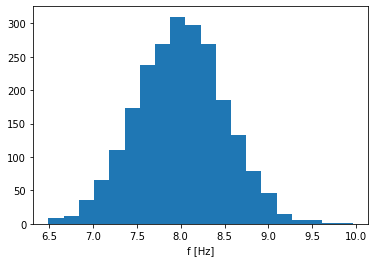

In [6]:
from IPython.display import display, Latex

print('Central frequency: ', f0)

for g in G_all[0::2]:
    txt = r'N: {0}, $f_\mu$: {1:.2f} Hz, $\theta_\mu$: {2:.2f} rad'.format(g.N, np.mean(g.omega/(2*pi)), np.mean(g.Theta))
    display(Latex(txt))
    print('Frequencies (raw): ', np.round(g.omega[:]/(2*pi),4))
    print()

plt.hist(omega0/(2*pi), bins=20)
plt.xlabel('f [Hz]')
plt.show()

In [7]:
# Network
net = Network()
net.add(G_K)
net.add(G_pop_avg)
net.add(G_all)
net.add(syn_all)
net.add(kuramoto_mon_all)
net.add(order_param_mon_all)

In [8]:
# Run the simulation
net.run(duration, report='text', report_period=10*second, profile=True)

WARNING    Came across an abstract code block that may not be well-defined: the outcome may depend on the order of execution. You can ignore this warning if you are sure that the order of operations does not matter. Abstract code: "ThetaPreInput_post = Theta_pre"
 [brian2.codegen.generators.base]
WARNING    Came across an abstract code block that may not be well-defined: the outcome may depend on the order of execution. You can ignore this warning if you are sure that the order of operations does not matter. Abstract code: "ThetaPreInput_post = Theta_pre"
 [brian2.codegen.generators.base]
WARNING    Came across an abstract code block that may not be well-defined: the outcome may depend on the order of execution. You can ignore this warning if you are sure that the order of operations does not matter. Abstract code: "ThetaPreInput_post = Theta_pre"
 [brian2.codegen.generators.base]
WARNING    Came across an abstract code block that may not be well-defined: the outcome may depend on the 

Starting simulation at t=0. s for a duration of 4. s
3.472 s (86%) simulated in 10s, estimated 2s remaining.
4. s (100%) simulated in 11s


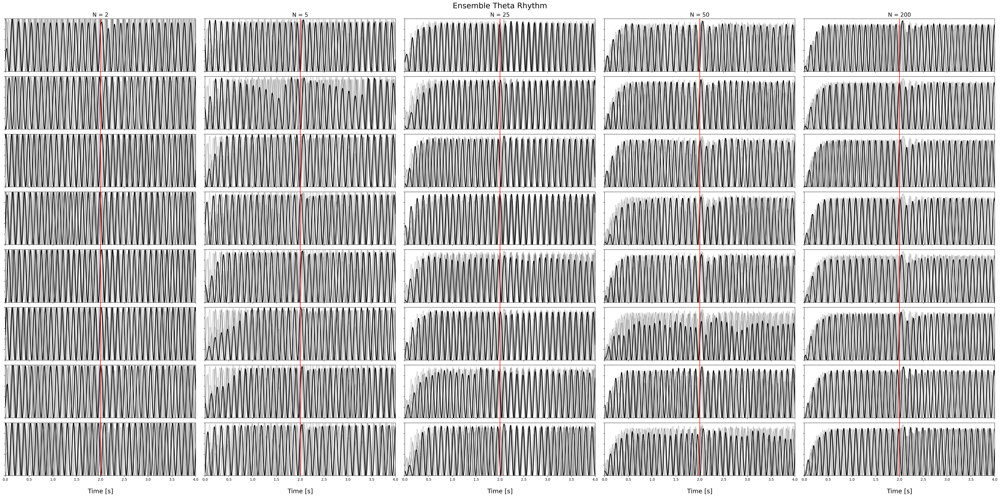

In [9]:
# Avoiding chartjunk [Rhythm]
fig, axs = subplots(repeats, len(N_init), figsize=(40,20), dpi=200)

fig.suptitle('Ensemble Theta Rhythm', fontsize=22, y=0.99)

idx = 0
for colnum in range(len(N_init)):
    for rownum in range(repeats):
        for gnum in range(repeats):
            if gnum == rownum:
                axs[rownum,colnum].plot(order_param_mon_all[idx*repeats + gnum].t/second, order_param_mon_all[idx*repeats + gnum].rhythm_pos[0], ls='-', linewidth=2, c='k', alpha=1, zorder=3)
            else:
                axs[rownum,colnum].plot(order_param_mon_all[idx*repeats + gnum].t/second, order_param_mon_all[idx*repeats + gnum].rhythm_pos[0], ls='-', c='k', alpha=0.2, zorder=2)

            axs[rownum,colnum].tick_params(axis='x',
                           which='both',
                           bottom=True,
                           top=False,
                           right=False,
                           left=True,
                           labelbottom=True,
                           labelleft=False)
        
        axs[rownum,colnum].set_ylim([0,1])
        axs[rownum,colnum].set_xlim([0,duration])
        axs[rownum,colnum].tick_params(axis='both',       # changes apply to both axes
                               which='both',      # both major and minor ticks are affected
                               bottom=True,       # ticks along the bottom edge are on
                               top=False,         # ticks along the top edge are on
                               right=False, 
                               left=True, 
                               labelbottom=False, # labels along the bottom edge are off
                               labelleft=False)
        vline = axs[rownum,colnum].axvline(x=t_stim/second, ymin=-1, ymax=1, c="red", linewidth=1.5, zorder=3, clip_on=False)

    idx += 1
    
    axs[0,colnum].set_title('N = %d' % N_init[colnum], fontsize=16)

    axs[-1,colnum].set_xlabel('Time [s]', fontsize=18, labelpad=20)
    axs[-1, colnum].tick_params(axis='x',
                           which='both',
                           bottom=True,
                           top=False,
                           right=False,
                           left=True,
                           labelbottom=True,
                           labelleft=False)
    # clip the last vline
    vline.set(clip_on=True)

fig.set_tight_layout(True)
fig.savefig('Ensemble Theta Rhythm RND - {0} Hz {1} {2}.png'.format(f0, N_init, repeats), facecolor='white', transparent=False)
plt.show()

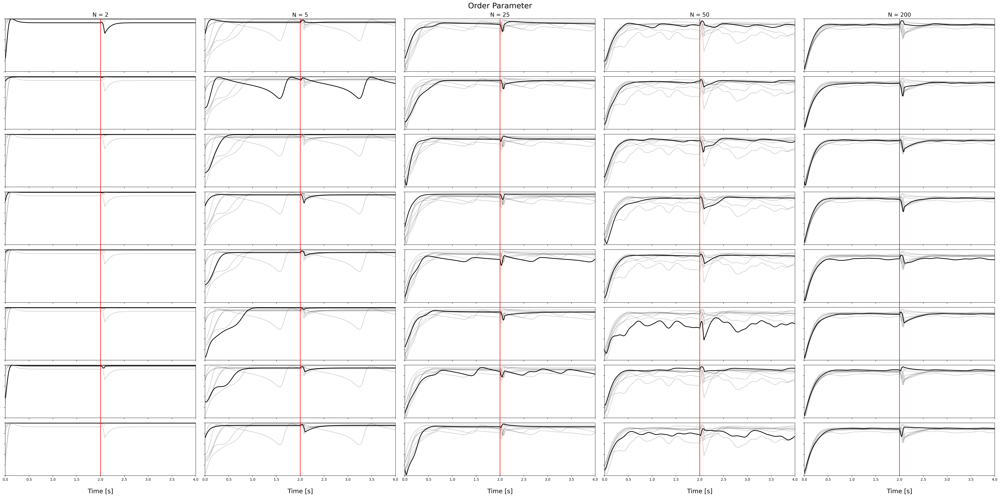

In [10]:
# Avoiding chartjunk [Order Param]
fig, axs = subplots(repeats, len(N_init), figsize=(40,20), dpi=200)

fig.suptitle('Order Parameter', fontsize=22, y=0.99)

idx = 0
for colnum in range(len(N_init)):
    for rownum in range(repeats):
        for gnum in range(repeats):
            if gnum == rownum:
                axs[rownum,colnum].plot(order_param_mon_all[idx*repeats + gnum].t/second, order_param_mon_all[idx*repeats + gnum].coherence[0], ls='-', linewidth=2, c='k', alpha=1, zorder=3)
            else:
                axs[rownum,colnum].plot(order_param_mon_all[idx*repeats + gnum].t/second, order_param_mon_all[idx*repeats + gnum].coherence[0], ls='-', c='k', alpha=0.2, zorder=2)

            axs[rownum,colnum].tick_params(axis='x',
                           which='both',
                           bottom=True,
                           top=False,
                           right=False,
                           left=True,
                           labelbottom=True,
                           labelleft=False)
        
        axs[rownum,colnum].set_ylim([0,1])
        axs[rownum,colnum].set_xlim([0,duration])
        axs[rownum,colnum].tick_params(axis='both',       # changes apply to both axes
                               which='both',      # both major and minor ticks are affected
                               bottom=True,       # ticks along the bottom edge are on
                               top=False,         # ticks along the top edge are on
                               right=False, 
                               left=True, 
                               labelbottom=False, # labels along the bottom edge are off
                               labelleft=False)
        vline = axs[rownum,colnum].axvline(x=t_stim/second, ymin=-1, ymax=1, c="red", linewidth=1.5, zorder=3, clip_on=False)

    idx += 1
    
    axs[0,colnum].set_title('N = %d' % N_init[colnum], fontsize=16)

    axs[-1,colnum].set_xlabel('Time [s]', fontsize=18, labelpad=20)
    axs[-1, colnum].tick_params(axis='x',
                           which='both',
                           bottom=True,
                           top=False,
                           right=False,
                           left=True,
                           labelbottom=True,
                           labelleft=False)
    # clip the last vline
    vline.set(clip_on=True)

fig.set_tight_layout(True)
fig.savefig('Order Parameter RND - {0} Hz {1} {2}.png'.format(f0, N_init, repeats), facecolor='white', transparent=False)
plt.show()

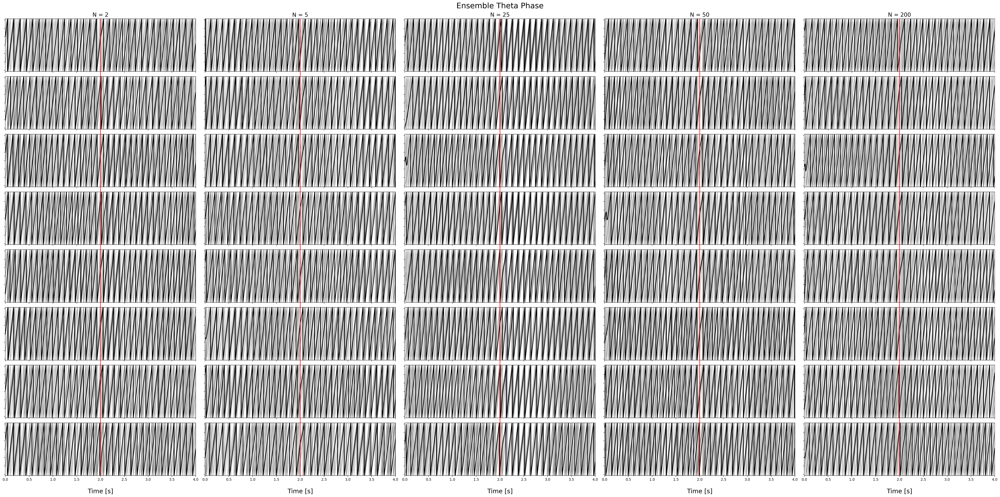

In [11]:
# Avoiding chartjunk [Phase]
fig, axs = subplots(repeats, len(N_init), figsize=(40,20), dpi=200)

fig.suptitle('Ensemble Theta Phase', fontsize=22, y=0.99)

idx = 0
for colnum in range(len(N_init)):
    for rownum in range(repeats):
        for gnum in range(repeats):
            if gnum == rownum:
                axs[rownum,colnum].plot(order_param_mon_all[idx*repeats + gnum].t/second, order_param_mon_all[idx*repeats + gnum].phase[0], ls='-', linewidth=2, c='k', alpha=1, zorder=3)
            else:
                axs[rownum,colnum].plot(order_param_mon_all[idx*repeats + gnum].t/second, order_param_mon_all[idx*repeats + gnum].phase[0], ls='-', c='k', alpha=0.2, zorder=2)

            axs[rownum,colnum].tick_params(axis='x',
                           which='both',
                           bottom=True,
                           top=False,
                           right=False,
                           left=True,
                           labelbottom=True,
                           labelleft=False)
        
        axs[rownum,colnum].set_ylim([-pi,pi])
        axs[rownum,colnum].set_xlim([0,duration])
        axs[rownum,colnum].tick_params(axis='both',       # changes apply to both axes
                               which='both',      # both major and minor ticks are affected
                               bottom=True,       # ticks along the bottom edge are on
                               top=False,         # ticks along the top edge are on
                               right=False, 
                               left=True, 
                               labelbottom=False, # labels along the bottom edge are off
                               labelleft=False)
        vline = axs[rownum,colnum].axvline(x=t_stim/second, ymin=-1, ymax=1, c="red", linewidth=1.5, zorder=3, clip_on=False)

    idx += 1
    
    axs[0,colnum].set_title('N = %d' % N_init[colnum], fontsize=16)

    axs[-1,colnum].set_xlabel('Time [s]', fontsize=18, labelpad=20)
    axs[-1, colnum].tick_params(axis='x',
                           which='both',
                           bottom=True,
                           top=False,
                           right=False,
                           left=True,
                           labelbottom=True,
                           labelleft=False)
    # clip the last vline
    vline.set(clip_on=True)

fig.set_tight_layout(True)
fig.savefig('Ensemble Theta Phase RND- {0} Hz {1} {2}.png'.format(f0, N_init, repeats), facecolor='white', transparent=False)
plt.show()